# **Topic Modeling with Llama2** 🦙
*Create easily interpretable topics with BERTopic and Llama 2*

Now that this intro is out of the way, let's start the hands-on tutorial!

We will start by installing a number of packages that we are going to use throughout this example:

# 📄 **Data**

We are going to apply topic modeling on a number of datasets. They are a great source for topic modeling since they contain a wide variety of topics and are generally well-written.

In [1]:
%%capture
!pip install bertopic datasets accelerate bitsandbytes xformers adjustText

In [2]:
from datasets import load_dataset

# Paste the "repo/dataset_name" string into "load_dataset"
dataset = load_dataset("argilla/databricks-dolly-15k-curated-en")["train"]

# Set dataset name and title. Will end up as name_of_file and Graph Titles.
dataset_name = "databricks-dolly-15k-curated".replace("-", "_").lower()
dataset_title = "Databricks Dolly (15k)"

# List the columns (features) and number of rows in this dataset
print(dataset)

Dataset({
    features: ['id', 'category', 'original-instruction', 'original-context', 'original-response', 'new-instruction', 'new-context', 'new-response', 'external_id'],
    num_rows: 15015
})


In [3]:
# Create variables for the columns we want to extract topics from
original_instruction = dataset["original-instruction"]
original_context = dataset["original-context"]
original_response = dataset["original-response"]

# 🛠 Data Conversion
### Convert the rows to a flat list of strings if necessary. 
Note: Set `conversations_raw` equal to `conversation_strings` if there's only one column and that column is just a list of strings.

In [4]:
# Turn the system prompts, inputs, instructions, responses and outputs into full conversations
conversations_raw = list(zip(original_instruction, original_context, original_response))

In [7]:
# Length of raw conversations
# NOTE: Should be equal to "num_rows" in dataset unless conversations span across rows
print(f"conversations_raw: {len(conversations_raw)}")

conversations_raw: 3000


In [5]:
# Preview one row of data after combining relevant columns
import json
print(json.dumps(conversations_raw[100], indent=4, ensure_ascii=True))

[
    "I started a new company named Greystone Inc. What do we do?",
    "",
    "- Investment banking for weird guys only\n- Aerospace consulting\n- Pasta and pasta accessory global logistics\n- Political lobbying for the mining industry"
]


In [6]:
# Convert each turn of a chat conversation into one long string on a per row basis
conversation_strings = []
for conversation in conversations_raw:
    messages = [turn.strip() for turn in conversation if turn]
    conversation_str = " ".join(messages)
    conversation_strings.append(conversation_str)

In [ ]:
# Preview the same row as earlier but all as one string
import json
print(json.dumps(conversation_strings[100], indent=4, ensure_ascii=True))

In [ ]:
# Length of conversations when reduced to list of strings
# NOTE: Should equal same length as conversations_raw
print(f"conversation_strings: {len(conversation_strings)}")

# 🔬 Analyzing
### Let's try to understand more about the dataset itself

In [8]:
# The next three conversations from this dataset
print(json.dumps(conversation_strings[101:104], indent=4, ensure_ascii=True))

[
    "Tell me whether or not these foods are on EWG's dirty dozen list avocados, kiwi, pairs, blueberries, green beans, kale, cabbage",
    "How much music theory knowledge is required to compose music? Technically speaking, very little music theory knowledge is \u201crequired\u201d to compose music. Music theory is, essentially, what musicians have learned over the course of several hundred years about how to write music that is interesting and sounds good. In other words, music theory is there to help you, not hold you back. \n\nWhen you learn music theory, what often happens is that you expand your broader understanding of music, which can be a very helpful safety net. The more music theory you know, the easier you\u2019ll be able to distinguish between the good ideas and the not-so-good. You need to know the rules before you can break them. You need to be able to write by the book before you throw the book away. If not, you run the risk of writing music that\u2019s not nearly as c

In [9]:
# Finding the shortest element (plus its length) in the conversation_strings list
shortest_conversation = min(conversation_strings, key=len)
length_of_shortest_conversation = len(shortest_conversation)

# Shortest convo index, convo, convo length
f"Index: {conversation_strings.index(shortest_conversation)}",shortest_conversation, f"Length: {length_of_shortest_conversation}"

('Index: 12352', 'Test Mike', 'Length: 9')

In [10]:
# Finding the longest element (plus its length) in the conversation_strings list
longest_conversation = max(conversation_strings, key=len)
length_of_longest_conversation = len(longest_conversation)

# Longest convo index, convo, convo length (truncated to 1000 characters because these can be very long)
f"Index: {conversation_strings.index(longest_conversation)}", longest_conversation[:1000], f"Length: {length_of_longest_conversation}"

('Index: 1868',
 'What is a console war in video games? In the video game industry, a console war describes the competition between two or more video game console manufacturers in trying to achieve better consumer sales through more advanced console technology, an improved selection of video games, and general marketing around their consoles. While console manufacturers are generally always trying to out-perform other manufacturers in sales, these console wars engage in more direct tactics to compare their offerings directly against their competitors or to disparage the competition in contrast to their own, and thus the marketing efforts have tended to escalate in back-and-forth pushes.\n\nWhile there have been many console wars to date, the term became popular between Sega and Nintendo during the late 1980s and early 1990s as Sega attempted to break into the United States video game market with its Sega Genesis console. Through a novel marketing approach and improved hardware, Sega ha

In [11]:
# This cell is for datasets that are longer than 100,000 rows long, use this method to reduce the size accordingly
if len(conversation_strings) > 150_000:
    step_size = round(len(conversation_strings) / 100_000)
    conversations_size = conversation_strings[::step_size]
    print(f"Step size: {step_size}")
else:
    conversations_size = conversation_strings
    print("No change.")

No change.


In [12]:
# Truncate any long conversations down to 10,000 characters because the context length of Llama 2 is 4096 tokens
conversations_truncate = [conv[:10_000] for conv in conversations_size]
print("Conversations truncated.")

Conversations truncated.


In [13]:
# If this number is less than 100K it needs to match the length of `conversation_strings` above, else ~100K in length
conversations = conversations_truncate
print(f"conversations: {len(conversations)}")

conversations: 15015


# 🤗 HuggingFace Hub Credentials
Before we can load in Llama2 using a number of tricks, we will first need to accept the License for using Llama2. The steps are as follows:


* Create a HuggingFace account [here](https://huggingface.co)
* Apply for Llama 2 access [here](https://huggingface.co/meta-llama/Llama-2-13b-chat-hf)
* Get your HuggingFace token [here](https://huggingface.co/settings/tokens)

After doing so, we can login with our HuggingFace credentials so that this environment knows we have permission to download the Llama 2 model that we are interested in.

In [14]:
# from huggingface_hub import notebook_login
# notebook_login()

# 🦙 **Llama 2**

Now comes one of the more interesting components of this tutorial, how to load in a Llama 2 model on a T4-GPU!

We will be focusing on the `'meta-llama/Llama-2-13b-chat-hf'` variant. It is large enough to give interesting and useful results whilst small enough that it can be run on our environment.

We start by defining our model and identifying if our GPU is correctly selected. We expect the output of `device` to show a cuda device:

In [15]:
from torch import cuda

model_id = 'NousResearch/Llama-2-13b-chat-hf'
device = f'cuda:{cuda.current_device()}' if cuda.is_available() else 'cpu'

print(device)

cuda:0


## **Optimization & Quantization**

In order to load our 13 billion parameter model, we will need to perform some optimization tricks. Since we have limited VRAM and not an A100 GPU, we will need to "condense" the model a bit so that we can run it.

There are a number of tricks that we can use but the main principle is going to be 4-bit quantization.

This process reduces the 64-bit representation to only 4-bits which reduces the GPU memory that we will need. It is a recent technique and quite an elegant at that for efficient LLM loading and usage. You can find more about that method [here](https://arxiv.org/pdf/2305.14314.pdf) in the QLoRA paper and on the amazing HuggingFace blog [here](https://huggingface.co/blog/4bit-transformers-bitsandbytes).

In [16]:
from torch import bfloat16
import transformers

# set quantization configuration to load large model with less GPU memory
# this requires the `bitsandbytes` library

bnb_config = transformers.BitsAndBytesConfig(
    load_in_4bit=True,  # 4-bit quantization
    bnb_4bit_quant_type='nf4',  # Normalized float 4
    bnb_4bit_use_double_quant=True,  # Second quantization after the first
    bnb_4bit_compute_dtype=bfloat16  # Computation type
)

These four parameters that we just run are incredibly important and bring many LLM applications to consumers:
* `load_in_4bit`
  * Allows us to load the model in 4-bit precision compared to the original 32-bit precision
  * This gives us an incredibly speed up and reduces memory!
* `bnb_4bit_quant_type`
  * This is the type of 4-bit precision. The paper recommends normalized float 4-bit, so that is what we are going to use!
* `bnb_4bit_use_double_quant`
  * This is a neat trick as it perform a second quantization after the first which further reduces the necessary bits
* `bnb_4bit_compute_dtype`
  * The compute type used during computation, which further speeds up the model.



Using this configuration, we can start loading in the model as well as the tokenizer:

In [17]:
# Llama 2 Tokenizer
tokenizer = transformers.AutoTokenizer.from_pretrained(model_id)

# Llama 2 Model
model = transformers.AutoModelForCausalLM.from_pretrained(
    model_id,
    trust_remote_code=True,
    quantization_config=bnb_config,
    device_map='auto',
)
model.eval()

Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

/home/models/ML/fine-tuning/bertopic/venv-topic/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:362: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.9` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`. This was detected when initializing the generation config instance, which means the corresponding file may hold incorrect parameterization and should be fixed.
  warnings.warn(
/home/models/ML/fine-tuning/bertopic/venv-topic/lib/python3.10/site-packages/transformers/generation/configuration_utils.py:367: UserWarning: `do_sample` is set to `False`. However, `top_p` is set to `0.6` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `top_p`. This was detected when initializing the generation config instance, which means the corresponding file may hold incorrect parameterization and should be fixed.
  warnings.warn(


LlamaForCausalLM(
  (model): LlamaModel(
    (embed_tokens): Embedding(32000, 5120, padding_idx=0)
    (layers): ModuleList(
      (0-39): 40 x LlamaDecoderLayer(
        (self_attn): LlamaAttention(
          (q_proj): Linear4bit(in_features=5120, out_features=5120, bias=False)
          (k_proj): Linear4bit(in_features=5120, out_features=5120, bias=False)
          (v_proj): Linear4bit(in_features=5120, out_features=5120, bias=False)
          (o_proj): Linear4bit(in_features=5120, out_features=5120, bias=False)
          (rotary_emb): LlamaRotaryEmbedding()
        )
        (mlp): LlamaMLP(
          (gate_proj): Linear4bit(in_features=5120, out_features=13824, bias=False)
          (up_proj): Linear4bit(in_features=5120, out_features=13824, bias=False)
          (down_proj): Linear4bit(in_features=13824, out_features=5120, bias=False)
          (act_fn): SiLUActivation()
        )
        (input_layernorm): LlamaRMSNorm()
        (post_attention_layernorm): LlamaRMSNorm()
      )


Using the model and tokenizer, we will generate a HuggingFace transformers pipeline that allows us to easily generate new text:

In [18]:
# Our text generator
generator = transformers.pipeline(
    model=model, tokenizer=tokenizer,
    task='text-generation',
    temperature=0.1,
    max_new_tokens=500,
    repetition_penalty=1.1
)

## **Prompt Engineering**

To check whether our model is correctly loaded, let's try it out with a few prompts.

In [19]:
# prompt = "Could you explain to me how 4-bit quantization works as if I am 5?"
# res = generator(prompt)
# print(res[0]["generated_text"])

Although we can directly prompt the model, there is actually a template that we need to follow. The template looks as follows:

```python
"""
<s>[INST] <<SYS>>

{{ System Prompt }}

<</SYS>>

{{ User Prompt }} [/INST]

{{ Model Answer }}
"""
```

This template consists of two main components, namely the `{{ System Prompt }}` and the `{{ User Prompt }}`:
* The `{{ System Prompt }}` helps us guide the model during a conversation. For example, we can say that it is a helpful assisant that is specialized in labeling topics.
* The  `{{ User Prompt }}` is where we ask it a question.

You might have noticed the `[INST]` tags, these are used to identify the beginning and end of a prompt. We can use these to model the conversation history as we will see more in-depth later on.

Next, let's see how we can use this template to optimize Llama 2 for topic modeling.

### **Prompt Template**

We are going to keep our `system prompt` simple and to the point:

In [20]:
# System prompt describes information given to all conversations
system_prompt = """
<s>[INST] <<SYS>>
You are a helpful, respectful and honest assistant for labeling topics.
<</SYS>>
"""

We will tell the model that it is simply a helpful assistant for labeling topics since that is our main goal.

In contrast, our `user prompt` is going to the be a bit more involved. It will consist of two components, an **example** and the **main prompt**.

Let's start with the **example**. Most LLMs do a much better job of generating accurate responses if you give them an example to work with. We will show it an accurate example of the kind of output we are expecting.

In [21]:
# Example prompt demonstrating the output we are looking for
example_prompt = """
I have a topic that contains the following documents:
- Traditional diets in most cultures were primarily plant-based with a little meat on top, but with the rise of industrial style meat production and factory farming, meat has become a staple food.
- Meat, but especially beef, is the word food in terms of emissions.
- Eating meat doesn't make you a bad person, not eating meat doesn't make you a good one.

The topic is described by the following keywords: 'meat, beef, eat, eating, emissions, steak, food, health, processed, chicken'.

Based on the information about the topic above, please create a short label of this topic. Less than 6 words. Make sure to only return the label and nothing more.

[/INST] Environmental impacts of eating meat
"""

This example, based on a number of keywords and documents primarily about the impact of
meat, helps to model to understand the kind of output it should give. We show the model that we were expecting only the label, which is easier for us to extract.

Next, we will create a template that we can use within BERTopic:

In [22]:
# Our main prompt with documents ([DOCUMENTS]) and keywords ([KEYWORDS]) tags
main_prompt = """
[INST]
I have a topic that contains the following documents:
[DOCUMENTS]

The topic is described by the following keywords: '[KEYWORDS]'.

Based on the information about the topic above, please create a short label of this topic. Less than 6 words. Make sure to only return the label and nothing more.
[/INST]
"""

There are two BERTopic-specific tags that are of interest, namely `[DOCUMENTS]` and `[KEYWORDS]`:

* `[DOCUMENTS]` contain the top 5 most relevant documents to the topic
* `[KEYWORDS]` contain the top 10 most relevant keywords to the topic as generated through c-TF-IDF

This template will be filled accordingly to each topic. And finally, we can combine this into our final prompt:

In [23]:
prompt = system_prompt + example_prompt + main_prompt

# 🗨️ **BERTopic**

Before we can start with topic modeling, we will first need to perform two steps:
* Pre-calculating Embeddings
* Defining Sub-models

## **Preparing Embeddings**

By pre-calculating the embeddings for each document, we can speed-up additional exploration steps and use the embeddings to quickly iterate over BERTopic's hyperparameters if needed.

🔥 **TIP**: You can find a great overview of good embeddings for clustering on the [MTEB Leaderboard](https://huggingface.co/spaces/mteb/leaderboard).

In [24]:
from sentence_transformers import SentenceTransformer

# Pre-calculate embeddings
embedding_model = SentenceTransformer("BAAI/bge-base-en-v1.5")
embeddings = embedding_model.encode(conversations, show_progress_bar=True)

Batches:   0%|          | 0/470 [00:00<?, ?it/s]

## **Sub-models**

Next, we will define all sub-models in BERTopic and do some small tweaks to the number of clusters to be created, setting random states, etc.

In [25]:
from umap import UMAP
from hdbscan import HDBSCAN

cluster_size = 25
umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=cluster_size, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

/home/models/ML/fine-tuning/bertopic/venv-topic/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/models/ML/fine-tuning/bertopic/venv-topic/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/models/ML/fine-tuning/bertopic/venv-to

As a small bonus, we are going to reduce the embeddings we created before to 2-dimensions so that we can use them for visualization purposes when we have created our topics.

In [26]:
# Pre-reduce embeddings for visualization purposes
reduced_embeddings = UMAP(n_neighbors=15, n_components=2, min_dist=0.0, metric='cosine', random_state=42).fit_transform(embeddings)

### 🏷 Bulk: Data Inspection

In [42]:
# Export a CSV file to use with the Bulk tool
import pandas as pd
bulk_df = pd.DataFrame({'text': conversations})

bulk_umap = UMAP(n_components=2)
X_tfm = bulk_umap.fit_transform(embeddings)

bulk_df['x'] = X_tfm[:, 0]
bulk_df['y'] = X_tfm[:, 1]

bulk_df.to_csv(f"datasets/bulk_{dataset_name}.csv", index=False)
print("CSV ready for Bulk.")

# CLI Commands:
# python -m bulk text datasets/bulk_dataset_name.csv
# python -m bulk text datasets/bulk_dataset_name.csv --keywords "topics,from,graphs"

CSV ready for Bulk.


### **Representation Models**

One of the ways we are going to represent the topics is with Llama 2 which should give us a nice label. However, we might want to have additional representations to view a topic from multiple angles.

Here, we will be using c-TF-IDF as our main representation and [KeyBERT](https://maartengr.github.io/BERTopic/getting_started/representation/representation.html#keybertinspired), [MMR](https://maartengr.github.io/BERTopic/getting_started/representation/representation.html#maximalmarginalrelevance), and [Llama 2](https://maartengr.github.io/BERTopic/getting_started/representation/llm.html) as our additional representations.

In [28]:
from bertopic.representation import KeyBERTInspired, MaximalMarginalRelevance, TextGeneration

# KeyBERT
keybert = KeyBERTInspired()

# MMR
mmr = MaximalMarginalRelevance(diversity=0.3)

# Text generation with Llama 2
llama2 = TextGeneration(generator, prompt=prompt)

# All representation models
representation_model = {
    "KeyBERT": keybert,
    "Llama2": llama2,
    "MMR": mmr,
}

# 🔥 **Training**

Now that we have our models prepared, we can start training our topic model! We supply BERTopic with the sub-models of interest, run `.fit_transform`, and see what kind of topics we get.

In [29]:
from bertopic import BERTopic

topic_model = BERTopic(

  # Sub-models
  embedding_model=embedding_model,
  umap_model=umap_model,
  hdbscan_model=hdbscan_model,
  representation_model=representation_model,

  # Hyperparameters
  top_n_words=10,
  verbose=True
)

# Train model
topics, probs = topic_model.fit_transform(conversations, embeddings)


2023-09-29 13:51:42,121 - BERTopic - Reduced dimensionality
2023-09-29 13:51:42,456 - BERTopic - Clustered reduced embeddings
100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 107/107 [01:35<00:00,  1.12it/s]


Now that we are done training our model, let's see what topics were generated:

In [30]:
# Show topics
topic_model.get_topic_info()

,Topic,Count,Name,Representation,KeyBERT,Llama2,MMR,Representative_Docs
0,-1,5034,-1_the_of_and_in,"[the, of, and, in, to, is, was, as, for, on]","[during, from, if, after, an, to, for, or, bas...","[Politics, Economy, and Relocation, , , , , , ...","[the, of, and, in, to, is, was, as, for, on]",[Provide a summary of Oliver Cromwell Applegat...
1,0,484,0_city_capital_cities_country,"[city, capital, cities, country, population, l...","[continent, countries, asia, world, europe, po...","[Geography of Countries, , , , , , , , , ]","[city, capital, cities, country, population, l...",[Given this paragraph that describes the count...
2,1,434,1_album_music_band_rock,"[album, music, band, rock, song, albums, pop, ...","[swift, singer, songwriter, song, taylor, gram...","[Taylor Swift's Achievements, , , , , , , , , ]","[album, music, band, rock, song, albums, pop, ...",[Mention the Record labels Taylor was associat...
3,2,373,2_rice_cheese_chicken_sauce,"[rice, cheese, chicken, sauce, biryani, meat, ...","[cooking, biryani, cook, chicken, cooked, cuis...","[Food preparation techniques, , , , , , , , , ]","[rice, cheese, chicken, sauce, biryani, meat, ...",[What are some best practices to prepare birya...
4,3,349,3_harry_potter_books_book,"[harry, potter, books, book, fiction, his, by,...","[rowling, hogwarts, weasley, potter, voldemort...","[Harry Potter book series, , , , , , , , , ]","[harry, potter, books, book, fiction, his, by,...",[Who is Harry Potter? Harry Potter is a series...
...,...,...,...,...,...,...,...,...
102,101,29,101_painter_painting_paintings_vermeer,"[painter, painting, paintings, vermeer, his, a...","[picasso, painter, gogh, painters, paintings, ...","[Artists and Their Work, , , , , , , , , ]","[painter, painting, paintings, vermeer, his, a...",[Give me the list of British artists born befo...
103,102,28,102_bird_identify_list_olive,"[bird, identify, list, olive, woodpecker, unde...","[birds, bird, hummingbird, goose, woodpecker, ...","[Identifying Birds, , , , , , , , , ]","[bird, identify, list, olive, woodpecker, unde...","[Identify the bird from the list: Racoon, Gold..."
104,103,28,103_transportation_travel_transport_ride,"[transportation, travel, transport, ride, publ...","[transport, traveling, transportation, travel,...","[Ways to travel without a car, , , , , , , , , ]","[transportation, travel, transport, ride, publ...",[What is a good way to get around without a ca...
105,104,26,104_baby_babies_sleep_cry,"[baby, babies, sleep, cry, your, toddlers, chi...","[babies, infant, baby, crying, cry, cries, wea...","[""Baby Sleep and Crying Tips"", , , , , , , , , ]","[baby, babies, sleep, cry, your, toddlers, chi...",[We are expecting a baby. Can you describe you...


In [31]:
topic_model.get_topic(1, full=True)["KeyBERT"]

[('swift', 0.62837255),
 ('singer', 0.61044025),
 ('songwriter', 0.6021003),
 ('song', 0.57844627),
 ('taylor', 0.57629585),
 ('grammy', 0.5675618),
 ('album', 0.56363463),
 ('singles', 0.5482946),
 ('songs', 0.5431423),
 ('billboard', 0.53509915)]

We got over 100 topics that were created and they all seem quite diverse.We can use the labels by Llama 2 and assign them to topics that we have created. Normally, the default topic representation would be c-TF-IDF, but we will focus on Llama 2 representations instead.


In [32]:
llama2_labels = [label[0][0].split("\n")[0] for label in topic_model.get_topics(full=True)["Llama2"].values()]
topic_model.set_topic_labels(llama2_labels)

# 📊 **Visualize**
We can go through each topic manually, which would take a lot of work, or we can visualize them all in a single interactive graph.
BERTopic has a bunch of [visualization functions](https://medium.com/r/?url=https%3A%2F%2Fmaartengr.github.io%2FBERTopic%2Fgetting_started%2Fvisualization%2Fvisualize_documents.html) that we can use. For now, we are sticking with visualizing the documents.

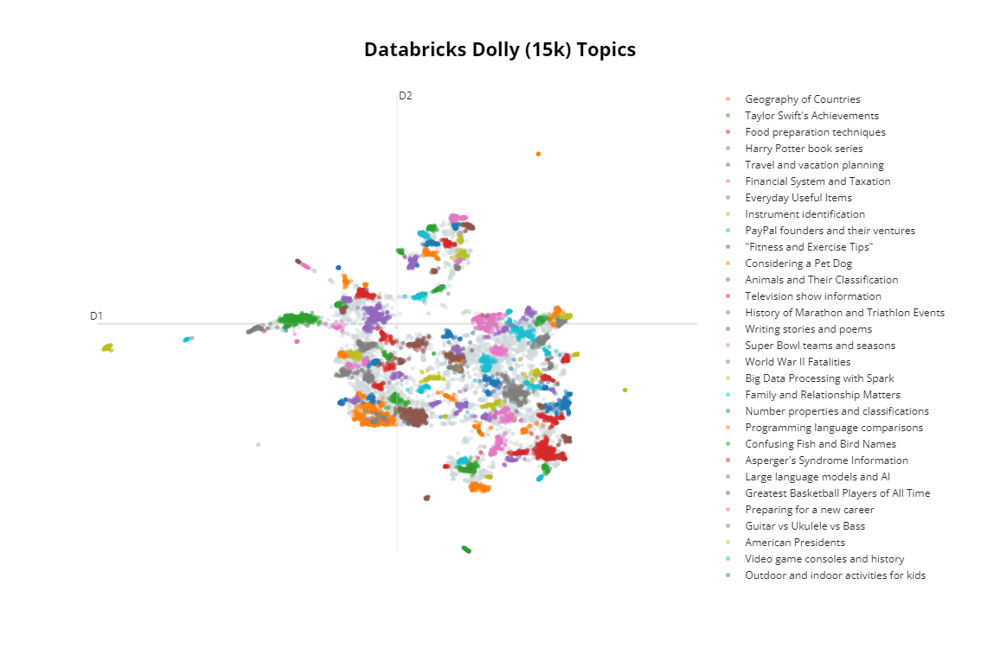

In [33]:
topic_scatter = topic_model.visualize_documents(conversations, title=f"<b>{dataset_title} Topics</b>", reduced_embeddings=reduced_embeddings, hide_annotations=True, hide_document_hover=False, custom_labels=True)
topic_scatter.write_html(f"graphs/{dataset_name}_{cluster_size}_scatter.html")
topic_scatter.write_image(f"graphs/{dataset_name}_{cluster_size}_scatter.png")
topic_scatter

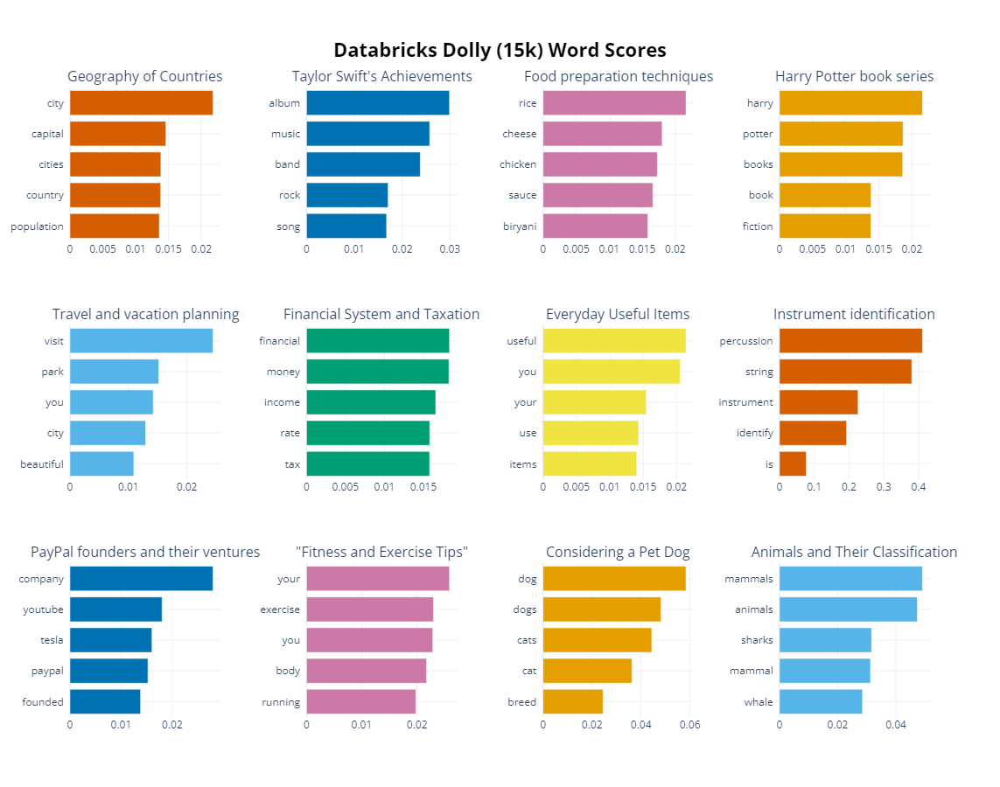

In [34]:
topic_word_scores = topic_model.visualize_barchart(top_n_topics=12, title=f"<b>{dataset_title} Word Scores</b>", custom_labels=True, width=300, height=300)
topic_word_scores.write_image(f"graphs/{dataset_name}_{cluster_size}_word_scores.png")
topic_word_scores

# 🖼️ (BONUS): **Advanced Visualization**

Although we can use the built-in visualization features of BERTopic, we can also create a static visualization that might be a bit more informative.

We start by creating the necessary variables that contain our reduced embeddings and representations:

In [35]:
import itertools
import pandas as pd

# Define colors for the visualization to iterate over
colors = itertools.cycle(['#e6194b', '#3cb44b', '#ffe119', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', '#fabebe', '#008080', '#e6beff', '#9a6324', '#fffac8', '#800000', '#aaffc3', '#808000', '#ffd8b1', '#000075', '#808080', '#ffffff', '#000000'])
color_key = {str(topic): next(colors) for topic in set(topic_model.topics_) if topic != -1}

# Prepare dataframe and ignore outliers
df = pd.DataFrame({"x": reduced_embeddings[:, 0], "y": reduced_embeddings[:, 1], "Topic": [str(t) for t in topic_model.topics_]})
df["Length"] = [len(doc) for doc in conversations]
df = df.loc[df.Topic != "-1"]
df = df.loc[(df.y > -10) & (df.y < 10) & (df.x < 10) & (df.x > -10), :]
df["Topic"] = df["Topic"].astype("category")

# Get centroids of clusters
mean_df = df.groupby("Topic").mean().reset_index()
mean_df.Topic = mean_df.Topic.astype(int)
mean_df = mean_df.sort_values("Topic")

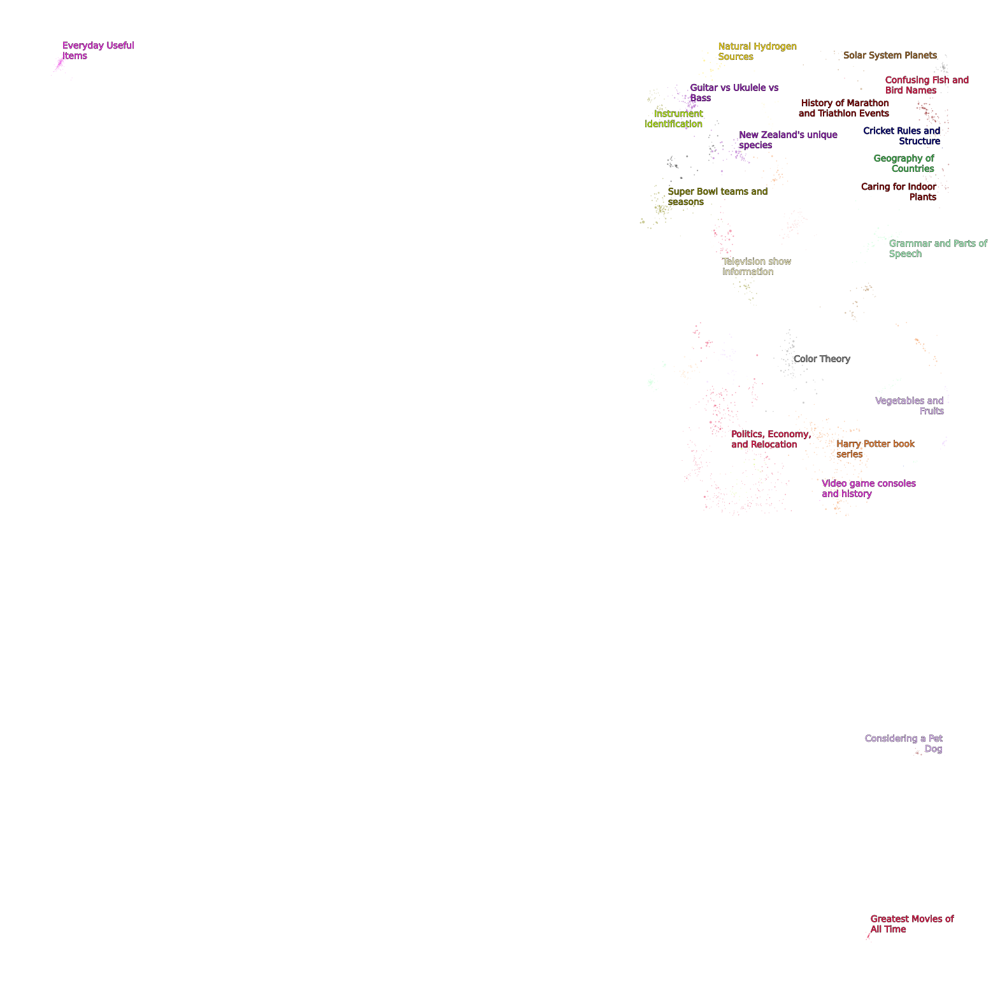

In [36]:
import seaborn as sns
from matplotlib import pyplot as plt
from adjustText import adjust_text
import matplotlib.patheffects as pe
import textwrap

fig = plt.figure(figsize=(20, 20))
sns.scatterplot(data=df, x='x', y='y', c=df['Topic'].map(color_key), alpha=0.4, sizes=(0.4, 10), size="Length")

# Annotate top 50 topics
texts, xs, ys = [], [], []
for row in mean_df.iterrows():
  topic = row[1]["Topic"]
  name = textwrap.fill(topic_model.custom_labels_[int(topic)], 20)

  if int(topic) <= 50:
    xs.append(row[1]["x"])
    ys.append(row[1]["y"])
    texts.append(plt.text(row[1]["x"], row[1]["y"], name, size=10, ha="center", color=color_key[str(int(topic))],
                          path_effects=[pe.withStroke(linewidth=0.5, foreground="black")]
                          ))

# Adjust annotations such that they do not overlap
adjust_text(texts, x=xs, y=ys, time_lim=1, force_text=(0.01, 0.02), force_static=(0.01, 0.02), force_pull=(0.5, 0.5))
plt.axis('off')
plt.legend('', frameon=False)
plt.savefig(f'graphs/{dataset_name}_{cluster_size}_plt.png')
plt.show()

# Backup Saving

In [37]:
# # To save: model, reduced embeddings, representative docs
# !pip install safetensors

In [38]:
# import pickle

# with open('rep_docs.pickle', 'wb') as handle:
#     pickle.dump(topic_model.representative_docs_, handle, protocol=pickle.HIGHEST_PROTOCOL)

# with open('reduced_embeddings.pickle', 'wb') as handle:
#     pickle.dump(reduced_embeddings, handle, protocol=pickle.HIGHEST_PROTOCOL)

# with open('filename.pickle', 'rb') as handle:
#     b = pickle.load(handle)

In [39]:
# embedding_model = "BAAI/bge-small-en"
# topic_model.save("final", serialization="safetensors", save_ctfidf=True, save_embedding_model=embedding_model)

In [40]:
# !zip -r /content/llama2.zip /content/final

In [41]:
# !jupyter nbconvert --to markdown Topic_Modeling_with_Llama2.ipynb